# Begin library

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras import Sequential
from keras.preprocessing.image import ImageDataGenerator
# Import necessary libraries for file handling
import os
import cv2
from PIL import Image
from tensorflow.keras.utils import img_to_array,load_img
from random import random
from numpy import load
from numpy import zeros
from numpy import ones
from numpy import asarray
from numpy import vstack
from numpy.random import randint
from keras.optimizers import Adam
from keras.initializers import RandomNormal
from keras.models import Model
from keras.layers import Input,Conv2D,Conv2DTranspose,LeakyReLU,Activation,Concatenate, MaxPooling2D, UpSampling2D

from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization

In [2]:
import os
#from keras.preprocessing.image import load_img, img_to_array
from numpy import asarray

def load_images(path, size):
    images = []
    # enumerate filenames in directory, assume all are images
    for filename in os.listdir(path):
        if os.path.isdir(os.path.join(path, filename)):
            continue
        # load and resize the image
        try:
            pixels = load_img(os.path.join(path, filename), target_size=size, color_mode='grayscale')
        except IsADirectoryError:
            continue
        # convert to numpy array
        pixels = img_to_array(pixels)
        # Ensure that the image has a single color channel
        pixels = pixels.reshape((size[0], size[1], 1))
        # store
        images.append(pixels)
    return asarray(images)


In [ ]:
from sklearn.utils import resample
clean_data_train_dir = 'images/clean_enh/' #mse_teste_clean#clean_croomb1pari_crossline_clean/'
noisy_data_train_dir = 'images/noise_enh/'#'images/pari_crossline_noise/'
#To get a subset of all images, for faster training during demonstration
dataA_all = load_images(noisy_data_train_dir , (512, 512))
dataA = resample(dataA_all, 
                 replace=True,     
                 n_samples=230,    
                 random_state=42) 
print('Loaded dataA: ', dataA.shape)

# load dataset B - Photos 
dataB_all = load_images(clean_data_train_dir , (512, 512))

#We could have just read the list of files and only load a subset, better memory management. 
dataB = resample(dataB_all, 
                 replace=True,     
                 n_samples=230,    
                 random_state=42) 
print('Loaded dataB: ', dataB.shape)
# plot source images
n_samples = 5
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + i)
    plt.axis('off')
    plt.imshow(dataA[i].astype('uint8'),cmap='gray')
# plot target image
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + n_samples + i)
    plt.axis('off')
    plt.imshow(dataB[i].astype('uint8'),cmap='gray')
plt.show()



# load image data
data = [dataA, dataB]
def preprocess_data(data):
    # load compressed arrays
    # unpack arrays
    X1, X2 = data[0], data[1]
    # scale from [0,255] to [-1,1]
    X1 = (X1 - 127.5) / 127.5
    X2 = (X2 - 127.5) / 127.5
    return [X1, X2]

dataset = preprocess_data(data)



In [111]:
import json
from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization
import pickle
#from tensorflow_addons.layers import InstanceNormalization
#Download instance norm. code from the link above.
#Or install keras_contrib using guidelines here: https://github.com/keras-team/keras-contrib 
#from instancenormalization import InstanceNormalization  

from matplotlib import pyplot
# discriminator model (70x70 patchGAN)
# C64-C128-C256-C512
#After the last layer, conv to 1-dimensional output, followed by a Sigmoid function.  
# The “axis” argument is set to -1 for instance norm. to ensure that features are normalized per feature map.
def define_discriminator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # source image input
    in_image = Input(shape=image_shape)
    # C64: 4x4 kernel Stride 2x2
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(in_image)
    d = LeakyReLU(alpha=0.2)(d)
    # C128: 4x4 kernel Stride 2x2
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = InstanceNormalization(axis=-1)(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C256: 4x4 kernel Stride 2x2
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = InstanceNormalization(axis=-1)(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C512: 4x4 kernel Stride 2x2 
    # Not in the original paper. Comment this block if you want.
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = InstanceNormalization(axis=-1)(d)
    d = LeakyReLU(alpha=0.2)(d)
    # second last output layer : 4x4 kernel but Stride 1x1
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = InstanceNormalization(axis=-1)(d)
    d = LeakyReLU(alpha=0.2)(d)
    # patch output
    patch_out = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    # define model
    model = Model(in_image, patch_out)
    # compile model
    #The model is trained with a batch size of one image and Adam opt. 
    #with a small learning rate and 0.5 beta. 
    #The loss for the discriminator is weighted by 50% for each model update.
    #This slows down changes to the discriminator relative to the generator model during training.
    model.compile(loss='mse', optimizer=Adam(learning_rate=0.0002, beta_1=0.5), loss_weights=[0.5])
    return model

# generator a resnet block to be used in the generator
# residual block that contains two 3 × 3 convolutional layers with the same number of filters on both layers.
def resnet_block(n_filters, input_layer):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # first convolutional layer
    g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(input_layer)
    g = InstanceNormalization(axis=-1)(g)
    g = Activation('relu')(g)
    # second convolutional layer
    g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(g)
    g = InstanceNormalization(axis=-1)(g)
    # concatenate merge channel-wise with input layer
    g = Concatenate()([g, input_layer])
    return g

# define the  generator model - encoder-decoder type architecture

#c7s1-k denote a 7×7 Convolution-InstanceNorm-ReLU layer with k filters and stride 1. 
#dk denotes a 3 × 3 Convolution-InstanceNorm-ReLU layer with k filters and stride 2.
# Rk denotes a residual block that contains two 3 × 3 convolutional layers
# uk denotes a 3 × 3 fractional-strided-Convolution InstanceNorm-ReLU layer with k filters and stride 1/2

#The network with 6 residual blocks consists of:
#c7s1-64,d128,d256,R256,R256,R256,R256,R256,R256,u128,u64,c7s1-3

#The network with 9 residual blocks consists of:
#c7s1-64,d128,d256,R256,R256,R256,R256,R256,R256,R256,R256,R256,u128, u64,c7s1-3

def define_generator(image_shape, n_resnet=9):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # image input
    in_image = Input(shape=image_shape)
    # c7s1-64
    g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
    g = InstanceNormalization(axis=-1)(g)
    g = Activation('relu')(g)
    # d128
    g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
    g = InstanceNormalization(axis=-1)(g)
    g = Activation('relu')(g)
    # d256
    g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
    g = InstanceNormalization(axis=-1)(g)
    g = Activation('relu')(g)
    # R256
    for _ in range(n_resnet):
        g = resnet_block(256, g)
    # u128
    g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
    g = InstanceNormalization(axis=-1)(g)
    g = Activation('relu')(g)
    # u64
    g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
    g = InstanceNormalization(axis=-1)(g)
    g = Activation('relu')(g)
    # c7s1-3
    g = Conv2D(1, (7,7), padding='same', kernel_initializer=init)(g)
    g = InstanceNormalization(axis=-1)(g)
    out_image = Activation('tanh')(g) 
    # g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
    # g = InstanceNormalization(axis=-1)(g)
    # out_image = Activation('tanh')(g)
    # # define model
    model = Model(in_image, out_image)
    return model

# define a composite model for updating generators by adversarial and cycle loss
#We define a composite model that will be used to train each generator separately. 
def define_composite_model(g_model_1, d_model, g_model_2, image_shape):
    # Make the generator of interest trainable as we will be updating these weights.
    #by keeping other models constant.
    #Remember that we use this same function to train both generators,
    #one generator at a time. 
    g_model_1.trainable = True #true em 30/04, novo treinamento em 01/04
    # mark discriminator and second generator as non-trainable
    d_model.trainable = False # true em 30/04
    g_model_2.trainable = False# true em 01/04

    # adversarial loss
    input_gen = Input(shape=image_shape)
    gen1_out = g_model_1(input_gen)
    output_d = d_model(gen1_out)
    # identity loss
    input_id = Input(shape=image_shape)
    output_id = g_model_1(input_id)
    # cycle loss - forward
    output_f = g_model_2(gen1_out)
    # cycle loss - backward
    gen2_out = g_model_2(input_id)
    output_b = g_model_1(gen2_out)

    # define model graph
    model = Model([input_gen, input_id], [output_d, output_id, output_f, output_b])

    # define the optimizer
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    # compile model with weighting of least squares loss and L1 loss
    model.compile(loss=['mse', 'mae', 'mae', 'mae'], 
                  loss_weights=[1, 5, 10, 10], optimizer=opt)
    return model

# load and prepare training images
def load_real_samples(filename):
    # load the dataset
    data = load(filename)
    # unpack arrays
    X1, X2 = data['arr_0'], data['arr_1']
    # scale from [0,255] to [-1,1]
    X1 = (X1 - 127.5) / 127.5
    X2 = (X2 - 127.5) / 127.5
    return [X1, X2]

# select a batch of random samples, returns images and target
#Remember that for real images the label (y) is 1. 
def generate_real_samples(dataset, n_samples, patch_shape):
    # choose random instances
    ix = randint(0, dataset.shape[0], n_samples)
    # retrieve selected images
    X = dataset[ix]
    # generate 'real' class labels (1)
    y = ones((n_samples, patch_shape, patch_shape, 1))
    return X, y

# generate a batch of images, returns images and targets
#Remember that for fake images the label (y) is 0. 
def generate_fake_samples(g_model, dataset, patch_shape):
    # generate fake images
    X = g_model.predict(dataset)
    # create 'fake' class labels (0)
    y = zeros((len(X), patch_shape, patch_shape, 1))
    return X, y

# periodically save the generator models to file
def save_models(step, g_model_AtoB, g_model_BtoA):
    # save the first generator model
    filename1 = 'g_model_AtoB_%06d.h5' % (step+1)
    g_model_AtoB.save(filename1)
    # save the second generator model
    filename2 = 'g_model_BtoA_%06d.h5' % (step+1)
    g_model_BtoA.save(filename2)
    print('>Saved: %s and %s' % (filename1, filename2))

# periodically generate images using the save model and plot input and output images
def summarize_performance(step, g_model, trainX, name, n_samples=5):
    # select a sample of input images
    X_in, _ = generate_real_samples(trainX, n_samples, 0)
    # generate translated images
    X_out, _ = generate_fake_samples(g_model, X_in, 0)
    # scale all pixels from [-1,1] to [0,1]
    X_in = (X_in + 1) / 2.0
    X_out = (X_out + 1) / 2.0
    # plot real images
    for i in range(n_samples):
        pyplot.subplot(2, n_samples, 1 + i)
        pyplot.axis('off')
        pyplot.imshow(X_in[i], cmap='gray')
    # plot translated image
    for i in range(n_samples):
        pyplot.subplot(2, n_samples, 1 + n_samples + i)
        pyplot.axis('off')
        pyplot.imshow(X_out[i], cmap='gray')
    # save plot to file
    filename1 = '%s_generated_plot_%06d.png' % (name, (step+1))
    pyplot.savefig(filename1)
    pyplot.close()

# update image pool for fake images to reduce model oscillation
# update discriminators using a history of generated images 
#rather than the ones produced by the latest generators.
#Original paper recommended keeping an image buffer that stores 
#the 50 previously created images.

def update_image_pool(pool, images, max_size=50):
    selected = list()
    for image in images:
        if len(pool) < max_size:
            # stock the pool
            pool.append(image)
            selected.append(image)
        elif random() < 0.5:
            # use image, but don't add it to the pool
            selected.append(image)
        else:
            # replace an existing image and use replaced image
            ix = randint(0, len(pool))
            selected.append(pool[ix])
            pool[ix] = image
    return asarray(selected)

def train(d_model_A, d_model_B, g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, dataset, epochs=1):
    # Define properties of the training run
    dA_losses1, dA_losses2, dB_losses1, dB_losses2, g_losses1, g_losses2 = [], [], [], [], [], []  # Dicionário para armazenar as perdas

    n_epochs, n_batch = epochs, 1  # Batch size fixed to 1 as suggested in the paper
    n_patch = d_model_A.output_shape[1]  # Determine the output square shape of the discriminator
    trainA, trainB = dataset  # Unpack dataset

    # Prepare image pool for fake images
    poolA, poolB = list(), list()
    bat_per_epo = int(len(trainA) / n_batch)
    n_steps = bat_per_epo * n_epochs

    # Early stopping parameters
    best_loss = float('inf')
    patience = 9500  # Number of epochs to wait after which training will be stopped if no improvement
    patience_counter = 0

    # Manually enumerate epochs
    for i in range(n_steps):
        X_realA, y_realA = generate_real_samples(trainA, n_batch, n_patch)
        X_realB, y_realB = generate_real_samples(trainB, n_batch, n_patch)
        X_fakeA, y_fakeA = generate_fake_samples(g_model_BtoA, X_realB, n_patch)
        X_fakeB, y_fakeB = generate_fake_samples(g_model_AtoB, X_realA, n_patch)

        # Update fake images in the pool
        X_fakeA = update_image_pool(poolA, X_fakeA)
        X_fakeB = update_image_pool(poolB, X_fakeB)

        # Update generators and discriminators
        g_loss2, _, _, _, _ = c_model_BtoA.train_on_batch([X_realB, X_realA], [y_realA, X_realA, X_realB, X_realA])
        dA_loss1 = d_model_A.train_on_batch(X_realA, y_realA)
        dA_loss2 = d_model_A.train_on_batch(X_fakeA, y_fakeA)
        g_loss1, _, _, _, _ = c_model_AtoB.train_on_batch([X_realA, X_realB], [y_realB, X_realB, X_realA, X_realB])
        dB_loss1 = d_model_B.train_on_batch(X_realB, y_realB)
        dB_loss2 = d_model_B.train_on_batch(X_fakeB, y_fakeB)
        
        dA_losses1.append(dA_loss1)
        dA_losses2.append(dA_loss2)
        dB_losses1.append(dB_loss1)
        dB_losses2.append(dB_loss2)
        g_losses1.append(g_loss1)
        g_losses2.append(g_loss2)

        # Calculate overall generator loss for early stopping
        average_generator_loss = (g_loss1 + g_loss2) / 2

        # Early stopping condition
        if average_generator_loss < best_loss:
            best_loss = average_generator_loss
            patience_counter = 0  # Reset patience counter
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"No improvement in generator loss for {patience} iterations, stopping training.")
                break

        # Periodically output the training status
        if (i + 1) % bat_per_epo == 0:
            summarize_performance(i, g_model_AtoB, trainA, 'AtoB')
            summarize_performance(i, g_model_BtoA, trainB, 'BtoA')
            if (i + 1) % (bat_per_epo * 5) == 0:
                save_models(i, g_model_AtoB, g_model_BtoA)

        # Provide update on training status
        print(f'Iteration>{i+1}, Disc losses [AtoB: {dA_loss1:.3f}, {dA_loss2:.3f}, BtoA: {dB_loss1:.3f}, {dB_loss2:.3f}], Gen Losses [AtoB: {g_loss1:.3f}, BtoA: {g_loss2:.3f}], Patience: {patience_counter}')
        loss_data = {
            'dA_losses1': dA_losses1,
            'dA_losses2': dA_losses2,
            'dB_losses1': dB_losses1,
            'dB_losses2': dB_losses2,
            'g_losses1': g_losses1,
            'g_losses2': g_losses2
        }

        with open('loss_data.pkl', 'wb') as f:
            pickle.dump(loss_data, f)

# Training

In [ ]:
import pickle
with tf.device('/GPU:0'):
    #new training from cycleGAN_model import define_generator, define_discriminator, define_composite_model, train
    #from keras.layers import Input
    # define input shape based on the loaded dataset
    image_shape = dataset[0].shape[1:]
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    # generator: A -> B
    cust = {'InstanceNormalization': InstanceNormalization}
    g_model_AtoB = load_model('g_model_AtoB_011500.h5', cust)#define_generator(image_shape)
    g_model_AtoB.compile(loss=['mse', 'mae', 'mae', 'mae'], 
                      loss_weights=[1, 5, 10, 10], optimizer=opt)
    # generator: B -> A
    g_model_BtoA = load_model('g_model_BtoA_011500.h5', cust)
    g_model_BtoA.compile(loss=['mse', 'mae', 'mae', 'mae'], 
                      loss_weights=[1, 5, 10, 10], optimizer=opt)# define_generator(image_shape)
    # discriminator: A -> [real/fake]
    d_model_A = define_discriminator(image_shape)
    # discriminator: B -> [real/fake]
    d_model_B = define_discriminator(image_shape)
    # composite: A -> B -> [real/fake, A]
    c_model_AtoB = define_composite_model(g_model_AtoB, d_model_B, g_model_BtoA, image_shape)
    # composite: B -> A -> [real/fake, B]
    c_model_BtoA = define_composite_model(g_model_BtoA, d_model_A, g_model_AtoB, image_shape)

    from datetime import datetime 
    start1 = datetime.now() 
    # train models
    train(d_model_A, d_model_B, g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, dataset, epochs=100)

    stop1 = datetime.now()
    #Execution time of the model 
    execution_time = stop1-start1
    print("Execution time is: ", execution_time)


In [ ]:
import pickle
with tf.device('/GPU:0'):
    # continuing training from cycleGAN_model import define_generator, define_discriminator, define_composite_model, train
    #from keras.layers import Input
    # define input shape based on the loaded dataset
    image_shape = dataset[0].shape[1:]
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    # generator: A -> B
    #cust = {'InstanceNormalization': InstanceNormalization}
    g_model_AtoB = define_generator(image_shape)
    #g_model_AtoB.compile(loss=['mse', 'mae', 'mae', 'mae'], 
    #                  loss_weights=[1, 5, 10, 10], optimizer=opt)
    # generator: B -> A
    g_model_BtoA = define_generator(image_shape)
    #g_model_BtoA.compile(loss=['mse', 'mae', 'mae', 'mae'], 
    #                  loss_weights=[1, 5, 10, 10], optimizer=opt)# define_generator(image_shape)
    # discriminator: A -> [real/fake]
    d_model_A = define_discriminator(image_shape)
    # discriminator: B -> [real/fake]
    d_model_B = define_discriminator(image_shape)
    # composite: A -> B -> [real/fake, A]
    c_model_AtoB = define_composite_model(g_model_AtoB, d_model_B, g_model_BtoA, image_shape)
    # composite: B -> A -> [real/fake, B]
    c_model_BtoA = define_composite_model(g_model_BtoA, d_model_A, g_model_AtoB, image_shape)

    from datetime import datetime 
    start1 = datetime.now() 
    # train models
    train(d_model_A, d_model_B, g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, dataset, epochs=200)

    stop1 = datetime.now()
    #Execution time of the model 
    execution_time = stop1-start1
    print("Execution time is: ", execution_time)


# Predictions bellow

In [98]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model
import numpy as np

# Função para carregar e preparar a imagem
def prepare_image(image_path, model_input_size=(512, 512)):
    # Carrega a imagem sem mudar seu tamanho
    img = load_img(image_path, color_mode='grayscale')
    # Converte a imagem para array
    img_array = img_to_array(img)
    
    # Verifica se o tamanho da imagem é diferente do esperado pelo modelo
    if img_array.shape[:2] != model_input_size:
        from tensorflow.image import resize
        # Redimensiona para o tamanho esperado pelo modelo
        img_array = resize(img_array, model_input_size)
    
    # Normaliza os valores dos pixels
    img_array=((img_array-127)/127)# /= 255.0
    # Expande as dimensões para simular um lote de tamanho 1
    img_array = np.expand_dims(img_array, axis=0)
    
    return img_array
opt = Adam(learning_rate=0.0002, beta_1=0.5)
# generator: A -> B
cust = {'InstanceNormalization': InstanceNormalization}

# Carregar modelos
#'models/g_model_AtoB_009000.h5'
model_AtoB = load_model('g_model_AtoB_004600A.h5',cust)
#model_AtoB.compile(loss=['mse', 'mae', 'mae', 'mae'], 
#                     loss_weights=[1, 5, 10, 10], optimizer=opt)
# Preparar a imagem
#selected
test_image_input = prepare_image('images/noise_comb2/noisy_P_inl_clean__461.png')#40% noise

#test_image_input = prepare_image('images/noise_enh/noisy_Kerry_580_inl.png')

# Fazendo a predição em etapas
pred_0 = model_AtoB.predict(test_image_input)
pred_1 = model_AtoB.predict(pred_0)
pred_2 = model_AtoB.predict(pred_1)

# Processo adicional, dependendo da sua aplicação


C:\Users\CometLake_05\anaconda3\envs\jrafael\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


1/1 [==============================] - 0s 124ms/step


In [65]:
from skimage.transform import resize
test_image_input = cv2.resize(np.squeeze(test_image_input), (2048, 2048))
tr_image_input = resize(np.squeeze(tr_image_input), (2048, 2048), anti_aliasing=True)
gen_image0 = resize(np.squeeze(pred_0), (2048, 2048), anti_aliasing=True)
gen_image1= resize(np.squeeze(pred_1), (2048, 2048), anti_aliasing=True)

In [103]:
import pandas as pd
from sewar.full_ref import mse, rmse, psnr

# Calculate MSE for each image comparison
mse_n = mse(tr_image_input, test_image_input)
mse_p0 = mse(tr_image_input, pred_0)
mse_p1 = mse(tr_image_input, pred_1)
mse_p2 = mse(tr_image_input, pred_2)

# Calculate RMSE for each image comparison
rmse_n = rmse(tr_image_input, test_image_input)
rmse_p0 = rmse(tr_image_input, pred_0)
rmse_p1 = rmse(tr_image_input, pred_1)
rmse_p2 = rmse(tr_image_input, pred_2)

# Determine the data range based on the image data type
data_range = tr_image_input.max() - tr_image_input.min()

# Calculate PSNR for each image comparison
psnr_n = psnr(tr_image_input, test_image_input, MAX=data_range)
psnr_p0 = psnr(tr_image_input, pred_0, MAX=data_range)
psnr_p1 = psnr(tr_image_input, pred_1, MAX=data_range)
psnr_p2 = psnr(tr_image_input, pred_2, MAX=data_range)


threshold = 0.05  # This threshold value can be adjusted
tar_image_binary = (tr_image_input > threshold).astype(np.uint8)
noisy_image0_binary = (test_image_input> threshold).astype(np.uint8)
gen_image0_binary = (pred_0 > threshold).astype(np.uint8)
gen_image1_binary = (pred_1 > threshold).astype(np.uint8)
gen_image2_binary = (pred_2 > threshold).astype(np.uint8)
# Calculate Jaccard index
jaccard_indexn= jaccard_score(tar_image_binary.flatten(), noisy_image0_binary.flatten(), average='binary')
jaccard_index0= jaccard_score(tar_image_binary.flatten(), gen_image0_binary.flatten(), average='binary')
jaccard_index1 = jaccard_score(tar_image_binary.flatten(), gen_image1_binary.flatten(), average='binary')
jaccard_index2 = jaccard_score(tar_image_binary.flatten(), gen_image2_binary.flatten(), average='binary')
jaccard_indexn, jaccard_index0,jaccard_index1,jaccard_index2
# Create a DataFrame to display the results as a table
results = pd.DataFrame({
    'Metric': ['MSE','JACCARD', 'RMSE', 'PSNR'],
    'Noisy': [mse_n,jaccard_indexn, rmse_n, psnr_n],
    'pred_0': [mse_p0,jaccard_index0, rmse_p0, psnr_p0],
    'pred_1': [mse_p1,jaccard_index1, rmse_p1, psnr_p1],
    'pred_2': [mse_p2,jaccard_index2, rmse_p2, psnr_p2]
})

# Identify the best (lowest) MSE, RMSE and best (highest) PSNR
best_mse_value = results.loc[results['Metric'] == 'MSE', ['Noisy','pred_0', 'pred_1', 'pred_2']].min(axis=1).values[0]
best_mse_image = results.loc[results['Metric'] == 'MSE', ['Noisy','pred_0', 'pred_1', 'pred_2']].idxmin(axis=1).values[0]
best_rmse_value = results.loc[results['Metric'] == 'RMSE', ['Noisy','pred_0', 'pred_1', 'pred_2']].min(axis=1).values[0]
best_rmse_image = results.loc[results['Metric'] == 'RMSE', ['Noisy','pred_0', 'pred_1', 'pred_2']].idxmin(axis=1).values[0]
best_psnr_value = results.loc[results['Metric'] == 'PSNR', ['Noisy','pred_0', 'pred_1', 'pred_2']].max(axis=1).values[0]
best_psnr_image = results.loc[results['Metric'] == 'PSNR', ['Noisy','pred_0', 'pred_1', 'pred_2']].idxmax(axis=1).values[0]
# Export the results to an Excel file
results.to_excel('comparison_results.xlsx', index=False)

# Print the results table
print(results)


# Print the best MSE, RMSE, and PSNR
print(f"\nBest MSE: {best_mse_value} from {best_mse_image}")
print(f"Best RMSE: {best_rmse_value} from {best_rmse_image}")
print(f"Best PSNR: {best_psnr_value} from {best_psnr_image}")


    Metric      Noisy     pred_0     pred_1     pred_2
0      MSE   0.300810   0.049032   0.042793   0.043777
1  JACCARD   0.490169   0.761140   0.757191   0.753614
2     RMSE   0.548462   0.221431   0.206864   0.209229
3     PSNR  11.271804  19.149948  19.741045  19.642297

Best MSE: 0.04279257201500963 from pred_1
Best RMSE: 0.20686365561647033 from pred_1
Best PSNR: 19.74104527123686 from pred_1


In [81]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import resize
from tensorflow.keras.preprocessing.image import load_img, img_to_array,array_to_img
A_r = np.vstack((pred_0))



def plot_one_image(image):
    image = prepare_image_i(image)  # Prepara a imagem ajustando tamanho e canais

    plt.figure(figsize=(12, 12))  # Cria uma nova figura com tamanho especificado
    plt.axis('off')  # Desativa os eixos

    plt.imshow(image, cmap='gray')
    plt.tight_layout(pad=0)# Exibe a imagem
    #plt.savefig('Kerry_p1.png')
    # Salva a figura
    plt.show()  # Mostra a imagem
# Simulando a criação de 'pred_0' para usar em np.vstack
def prepare_image_i(image):
        if image.shape[-1] == 1:  # Verifica se o último eixo tem tamanho 1
            image = np.squeeze(image)  # Remove o eixo do canal
        return resize(image, (1024,1024,1), mode='reflect', anti_aliasing=True)
def save_image(image, filename='Kerry_inli2_580_p1.png'):
    image =prepare_image_i(image)
    image=array_to_img(image)# Removes unnecessary dimensions if there's any
      # Assuming the image data is in float format ranging from 0 to 1
    #image_pil = Image.fromarray(image)  # Convert the numpy array to a PIL Image object
    image.save(filename)  # Save the PIL Image object to a file

# Chama a função para plotar a imagem
#plot_one_image(A_r)
save_image(pred_0)


In [71]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import resize
from skimage.metrics import peak_signal_noise_ratio

def plot_three_images(imageN, imageG, imageR, region):
    # Helper function to resize and remove extra channel if present
    def prepare_image_i(image):
        if image.shape[-1] == 1:  # Check if the last axis has size 1
            image = np.squeeze(image)  # Remove the channel axis
        return resize(image, (800, 800), mode='reflect', anti_aliasing=True)

    imageN = prepare_image_i(imageN)
    imageG = prepare_image_i(imageG)
    imageR = prepare_image_i(imageR)

    images = [imageN, imageG, imageR]
    titles = ['Noisy', 'Denoised+Enhanced', 'Real']
    
    # Setting parameters based on region
    if region.lower() == "kerry":
        y_label = "Time (ms)"
        y_ticks_values = list(range(0, 5001, 500))  # Time in ms
        y_ticks_positions = [y / 5000 * 800 for y in y_ticks_values]  # Scaling to image size
        x_label = "Number of traces"
        x_ticks_values = list(range(510, 736, 45))  # Number of traces
        x_ticks_positions = [(x - 510) / (735 - 510) * 800 for x in x_ticks_values]  # Scaling to image size
    elif region.lower() == "parihaka":
        y_label = "Time (ms)"
        y_ticks_values = list(range(0, 3501, 550))  # Time in ms
        y_ticks_positions = [y / 3500 * 800 for y in y_ticks_values]  # Scaling to image size
        x_label = "Number of traces"
        x_ticks_values = list(range(1, 1126, 199))  # Number of traces
        x_ticks_positions = [(x - 1) / (1125 - 1) * 800 for x in x_ticks_values]  # Scaling to image size
    else:
        raise ValueError("Invalid region specified. Choose 'Kerry' or 'Parihaka'.")

    # Create the figure and subplots with desired size and DPI
    fig, axes = plt.subplots(1, 3, figsize=(12, 5))

    for i, (img, title) in enumerate(zip(images, titles)):
        ax = axes[i]
        ax.imshow(img, cmap='gray')
        ax.set_title(title, fontsize=14)
        ax.set_xlabel(x_label, fontsize=14)
        ax.set_xticks(x_ticks_positions, fontsize=14)
        ax.set_xticklabels([str(x) for x in x_ticks_values], fontsize=14)
        if i == 0:
            ax.set_ylabel(y_label, fontsize=14)
            ax.set_yticks(y_ticks_positions, fontsize=14)
            ax.set_yticklabels([str(y) for y in y_ticks_values], fontsize=14)
        else:
            ax.set_yticks([], fontsize=14)

    plt.tight_layout(pad=0.2)
    #plt.savefig('pari_clean_461_comp.eps')
    plt.show()

# Usage example
# Assuming 'imageN', 'imageG', 'imageR' are arrays of shape (800, 800):
# plot_three_images(imageN, imageG, imageR, 'Kerry')


In [69]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import resize
from skimage.metrics import peak_signal_noise_ratio
def plot_three_images(imageN, imageG, imageR):
    # Função para redimensionar e remover o canal extra se for 1
    def prepare_image_i(image):
        if image.shape[-1] == 1:  # Verifica se o último eixo tem tamanho 1
            image = np.squeeze(image)  # Remove o eixo do canal
        return resize(image, (800, 800), mode='reflect', anti_aliasing=True)

    imageN = prepare_image_i(imageN)
    imageG = prepare_image_i(imageG)
    imageR = prepare_image_i(imageR)

    images = [imageN, imageG, imageR]
    titles = ['Noisy', 'Denoised', 'Real']
    #print(f'PSNR of predicted image is {peak_signal_noise_ratio(imageR,imageG)}')
    # Criar a figura e os subplots com o tamanho e DPI desejados
    fig, axes = plt.subplots(1, 3, figsize=(12, 20))

    for i, img in enumerate(images):
        ax = axes[i]
        ax.imshow(img, cmap='gray')
        ax.tick_params(axis='both', which='major', labelsize=14)
        ax.set_xlabel('Number of traces', fontsize=14)
        ax.set_title(titles[i], fontsize=14)
        if i == 0:
            ax.set_ylabel('Time(ms)', fontsize=14)
        else:
            ax.set_yticks([])

    plt.tight_layout(pad=0.2)
    #plt.savefig('pari_cros_381_comp.eps')
    plt.show()

# Supondo que você já tenha as imagens (test_image_input, pred_1, tr_image_input) como arrays do NumPy:
# plot_three_images(test_image_input, pred_1, tr_image_input)



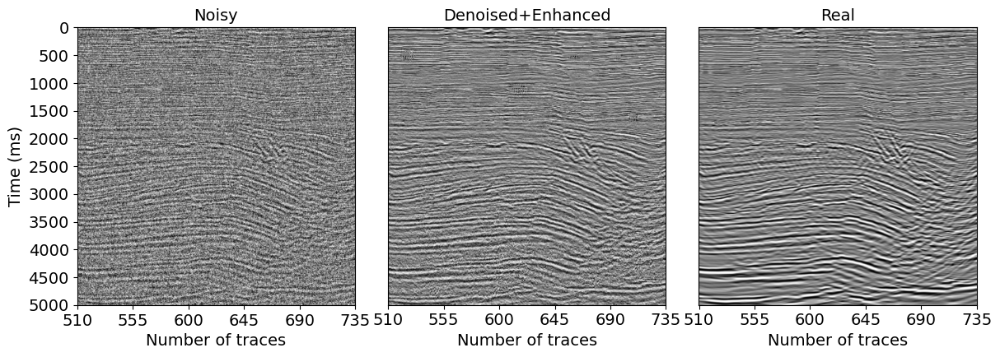

In [105]:
plot_three_images(test_image_input, pred_1,tr_image_input,"kerry")#%kerry 580 model 9200

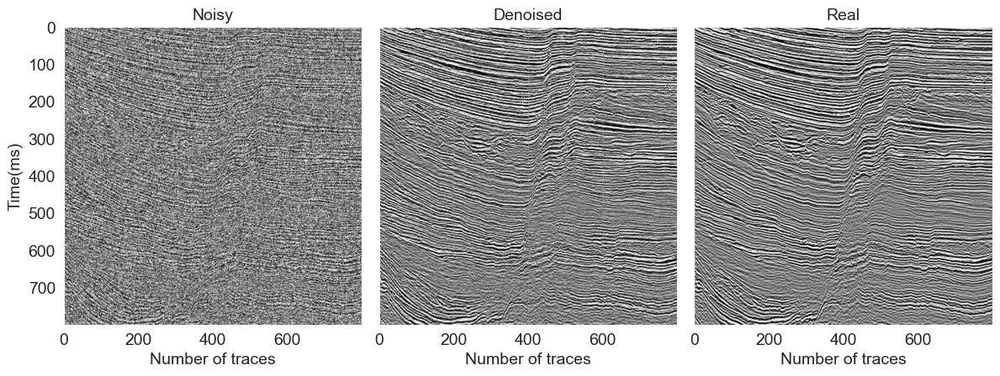

In [459]:
plot_three_images(test_image_input, pred_0,tr_image_input)#%parihaka 461 model 11500

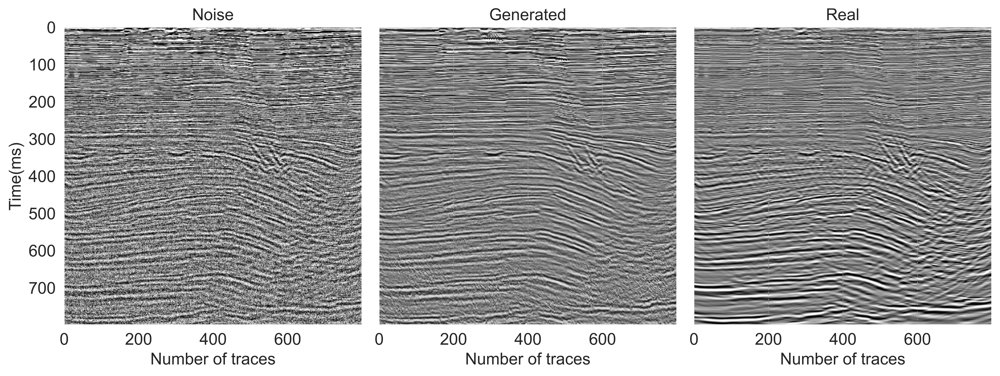

In [366]:
plot_three_images(test_image_input, pred_2,tr_image_input)#%kerry 580 model 11500

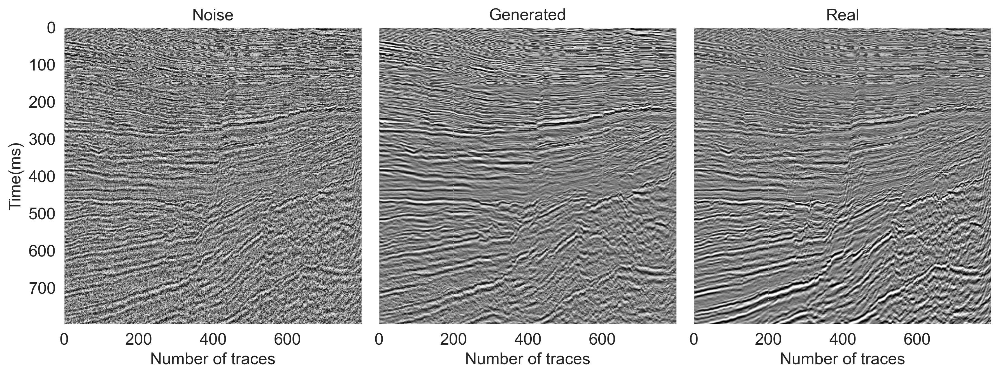

In [276]:
plot_three_images(test_image_input, pred_1,tr_image_input)#%50

In [266]:
plot_three_images(test_image_input, pred_0,tr_image_input)#%50

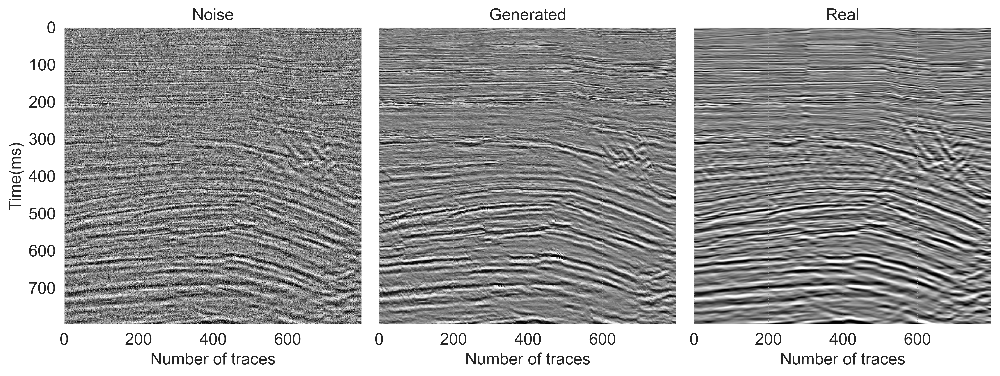

In [118]:
plot_three_images(test_image_input, pred_0,tr_image_input)#%50

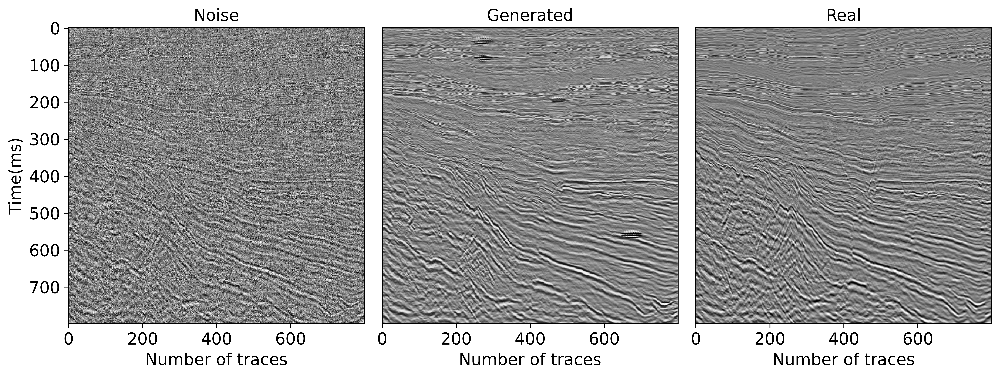

In [81]:
plot_three_images(test_image_input, pred_2,tr_image_input)#%50

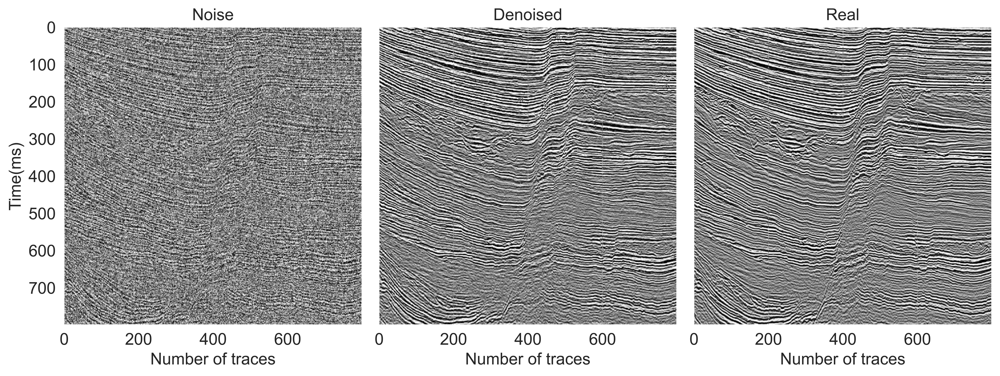

In [407]:
plot_three_images(test_image_input, pred_1,tr_image_input)#%50

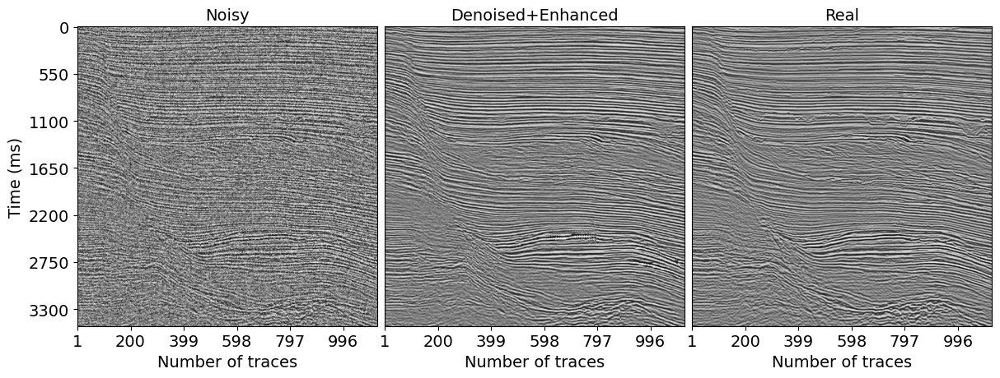

In [136]:
plot_three_images(test_image_input, pred_1,tr_image_input,'parihaka')#%50

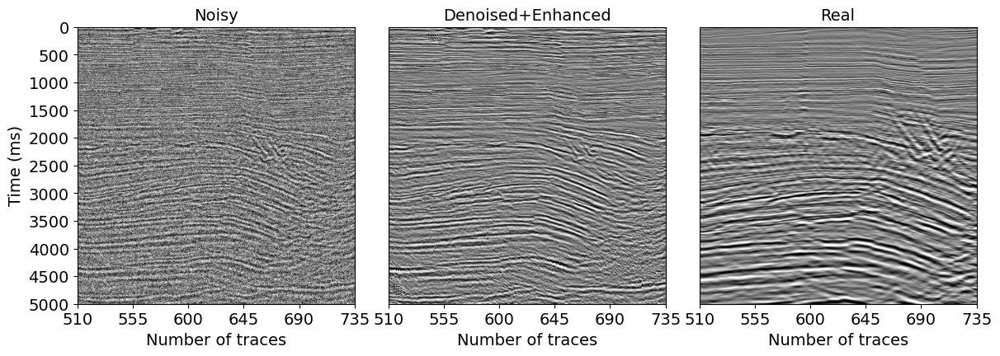

In [181]:
plot_three_images(test_image_input, pred_0,tr_image_input,'kerry')#%40

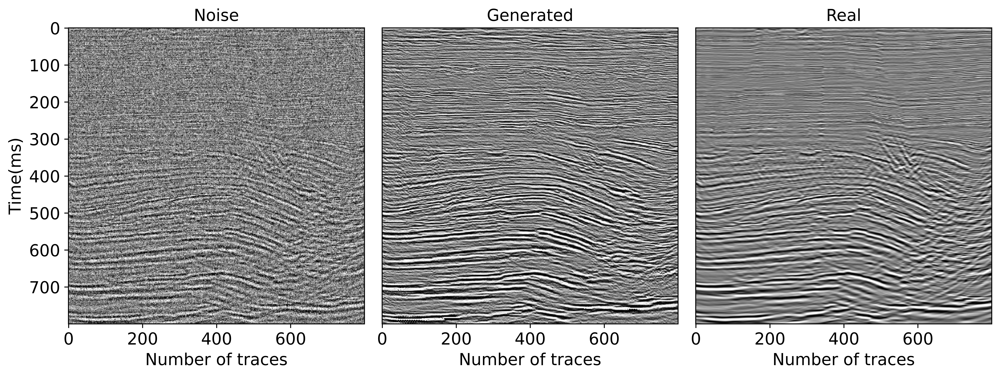

In [16]:
plot_three_images(test_image_input, pred_1,tr_image_input)#30%

# Error calculation

In [94]:
import numpy as np
from skimage.transform import resize
from skimage.metrics import peak_signal_noise_ratio as psnr
from sewar.full_ref import mse, rmse
from skimage import img_as_ubyte
from sklearn.metrics import jaccard_score
import cv2

# Assuming src_image, tar_image, and gen_image are already defined

# Resize images
#src_image = cv2.resize(np.squeeze(src_image), (2048, 2048))
tar_image = resize(np.squeeze(tr_image_input), (2048, 2048))#, anti_aliasing=True)
gen_image0 = resize(np.squeeze(pred_0), (2048, 2048))#, anti_aliasing=True)
gen_image1= resize(np.squeeze(pred_1), (2048, 2048))#, anti_aliasing=True)
gen_image2= resize(np.squeeze(pred_2), (2048, 2048))#, anti_aliasing=True)
noisy_image= resize(np.squeeze(test_image_input), (2048, 2048))#, anti_aliasing=True)
# PSNR calculation
data_range = tar_image.max() - tar_image.min()
psnr0_value = psnr(tar_image, gen_image0, data_range=data_range)
psnr1_value = psnr(tar_image, gen_image1, data_range=data_range)
psnr2_value= psnr(tar_image, gen_image2, data_range=data_range)
# Convert images to binary (0 and 1)
threshold = 0.05  # This threshold value can be adjusted
tar_image_binary = (tar_image > threshold).astype(np.uint8)
noisy_image0_binary = (noisy_image> threshold).astype(np.uint8)
gen_image0_binary = (gen_image0 > threshold).astype(np.uint8)
gen_image1_binary = (gen_image1 > threshold).astype(np.uint8)
gen_image2_binary = (gen_image2 > threshold).astype(np.uint8)
# Calculate Jaccard index
jaccard_indexn= jaccard_score(tar_image_binary.flatten(), noisy_image0_binary.flatten(), average='binary')
jaccard_index0= jaccard_score(tar_image_binary.flatten(), gen_image0_binary.flatten(), average='binary')
jaccard_index0= jaccard_score(tar_image_binary.flatten(), gen_image0_binary.flatten(), average='binary')
jaccard_index1 = jaccard_score(tar_image_binary.flatten(), gen_image1_binary.flatten(), average='binary')
jaccard_index2 = jaccard_score(tar_image_binary.flatten(), gen_image2_binary.flatten(), average='binary')
psnr0_value,psnr1_value,psnr2_value,jaccard_indexn, jaccard_index0,jaccard_index1,jaccard_index2


(20.602759310449375,
 19.95907321957049,
 19.645820730501008,
 0.5440447818915622,
 0.7220803260743812,
 0.7096844076670982,
 0.6998655095613059)

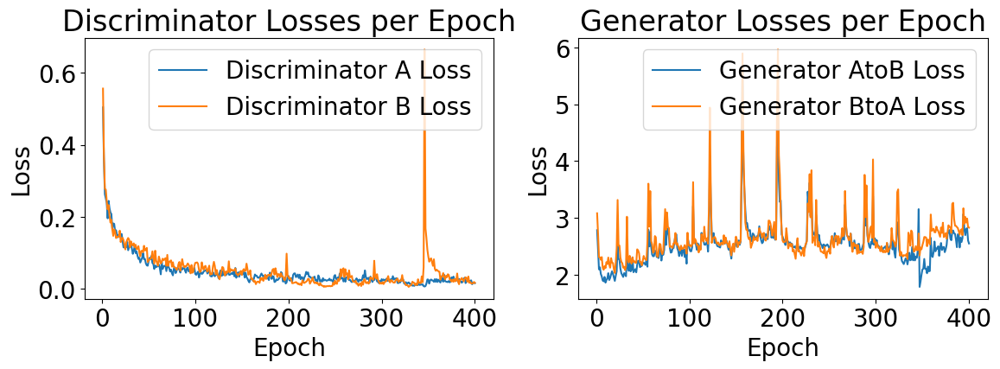

In [225]:
import pickle
import matplotlib.pyplot as plt
import numpy as np

def load_and_plot_losses(file_path, target_epochs=400):
    with open(file_path, 'rb') as file:
        loss_data = pickle.load(file)
    
    dA_losses = loss_data['dA_losses1']
    dB_losses = loss_data['dB_losses1']
    gA_losses = loss_data['g_losses1']
    gB_losses = loss_data['g_losses2']

    total_iterations = len(dA_losses)
    factor = total_iterations // target_epochs

    def downsample_losses(losses, factor):
        losses = np.array(losses)  # Convert list to NumPy array
        return np.mean(losses[:len(losses) - len(losses) % factor].reshape(-1, factor), axis=1)

    dA_losses = downsample_losses(dA_losses, factor)
    dB_losses = downsample_losses(dB_losses, factor)
    gA_losses = downsample_losses(gA_losses, factor)
    gB_losses = downsample_losses(gB_losses, factor)

    epochs = range(1, target_epochs + 1)
    plt.rcParams.update({'font.size': 20})
    plt.figure(figsize=(12, 8))

    plt.subplot(2, 2, 1)
    plt.plot(epochs, dA_losses, label='Discriminator A Loss')
    plt.plot(epochs, dB_losses, label='Discriminator B Loss')
    plt.title('Discriminator Losses per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(2, 2, 2)
    plt.plot(epochs, gA_losses, label='Generator AtoB Loss')
    plt.plot(epochs, gB_losses, label='Generator BtoA Loss')
    plt.title('Generator Losses per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.savefig('loss_image_1.png')
    plt.show()

file_path = 'loss_data_0.pkl'
load_and_plot_losses(file_path)


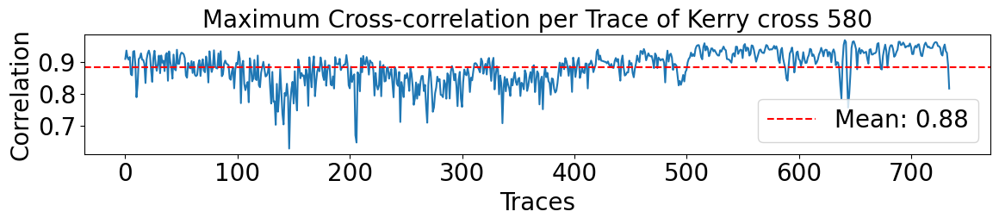

In [79]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_xcorr(dataA, dataB):
    # Ensure the data arrays are writable by making copies
    dataA = np.copy(dataA)
    dataB = np.copy(dataB)

    xcorr_zero = np.zeros(dataA.shape[0])
    xcorr_max = np.zeros(dataA.shape[0])
    for i in range(len(dataA)):
        dataA_flat = dataA[i].flatten()  # Flatten in case the input arrays are not 1D
        dataB_flat = dataB[i].flatten()

        dataA_flat = (dataA_flat - np.mean(dataA_flat)) / (np.std(dataA_flat) * len(dataA_flat))
        dataB_flat = (dataB_flat - np.mean(dataB_flat)) / np.std(dataB_flat)

        xcorr_temp = np.correlate(dataA_flat, dataB_flat, mode="full")
        middleIndex = int((len(xcorr_temp) - 1) / 2)
        xcorr_zero[i] = xcorr_temp[middleIndex]
        xcorr_max[i] = max(xcorr_temp)

    return xcorr_max, xcorr_zero
def prepare_image_i(image):
        if image.shape[-1] == 1:
            image = np.squeeze(image)
        return resize(image, (735, 1000))


imageG = prepare_image_i(pred_0)
imageR = prepare_image_i(tr_image_input)
xcorr_max, xcorr_zero = calculate_xcorr(imageR, imageG)
# Definindo o tamanho da figura
figsize = (12, 3)  # Substitua pelo tamanho desejado (largura, altura)

# Criando a figura e os eixos
fig, ax = plt.subplots(figsize=figsize)

# Plotando com os eixos invertidos
ax.plot(np.arange(len(xcorr_max)), xcorr_max)  # x são os valores de correlação, y é o índice de trace

# Invertendo o eixo y
#ax.invert_yaxis()

# Adicionando uma linha pontilhada vermelha com a média
mean_xcorr_max = np.mean(xcorr_max)
ax.axhline(mean_xcorr_max, color='red', linestyle='--', label=f'Mean: {mean_xcorr_max:.2f}')

# Adicionando a legenda
ax.legend(fontsize=20)

# Definindo rótulos e título com tamanho de fonte 14
ax.set_ylabel('Correlation', fontsize=20)
ax.set_xlabel('Traces', fontsize=20)
ax.set_title('Maximum Cross-correlation per Trace of Kerry cross 580', fontsize=20)

# Configurando o tamanho da fonte dos ticks dos eixos
ax.tick_params(axis='both', which='major', labelsize=20)
plt.tight_layout()
# Salvando a figura em formato EPS
output_filename = 'c_kerry_3.png'  # Substitua pelo nome desejado do arquivo
plt.savefig(output_filename, format='png')

# Exibindo o gráfico
plt.show()